In [4]:
import os
import pandas as pd
import folium
import seaborn as sns
import matplotlib.pyplot as plt

In [5]:
cwd = os.getcwd()
if os.path.basename(cwd) == "Notebooks":
    project_root = os.path.dirname(cwd)
else:
    project_root = cwd
path = os.path.join(project_root, "data", "Airbnb_DK_Processed_Data.csv")
df = pd.read_csv(path)

In [6]:
# plot of Airbnb listings in CPH (5000 random samples)
cph_center = [55.6761, 12.5683]
m = folium.Map(location=cph_center, zoom_start=11, tiles='cartodbpositron')
for _, row in df.sample(5000, random_state=1).iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=1,
        color="red",
        fill=True,
        fill_opacity=0.6
    ).add_to(m)
m

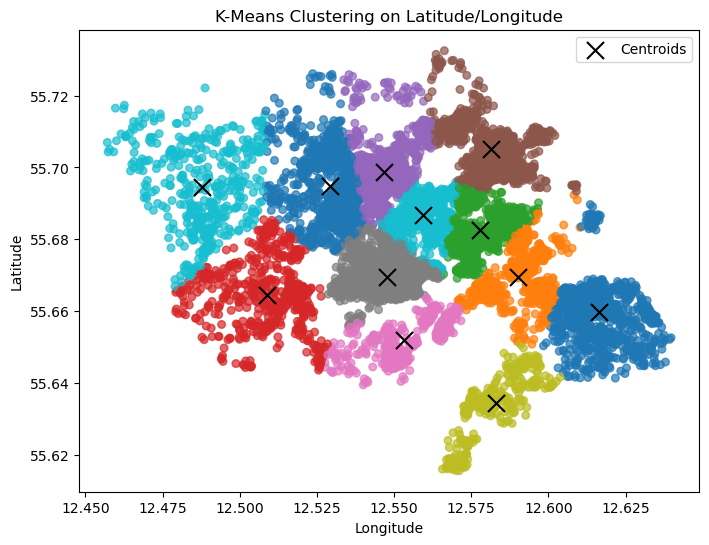

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# --- Assume df contains 'latitude' and 'longitude' columns ---

# Step 1: Extract coordinates
X = df[['longitude', 'latitude']].values

# Step 2: Choose number of clusters (you can tune this)
k = 12  # Example: 8 clusters
kmeans = KMeans(n_clusters=k, random_state=42)

# Step 3: Fit the model and get cluster labels
df['k-cluster'] = kmeans.fit_predict(X)

# Step 4: Add cluster centers
centers = kmeans.cluster_centers_

# Step 5: Plot clusters
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=df['k-cluster'], cmap='tab10', s=30, alpha=0.7)
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=150, marker='x', label='Centroids')
plt.title('K-Means Clustering on Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend()
plt.show()


C:\Users\morte\AppData\Local\Temp\ipykernel_8388\1933073511.py:22: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = plt.cm.get_cmap('tab10', np.max(df['db-cluster']) + 2)


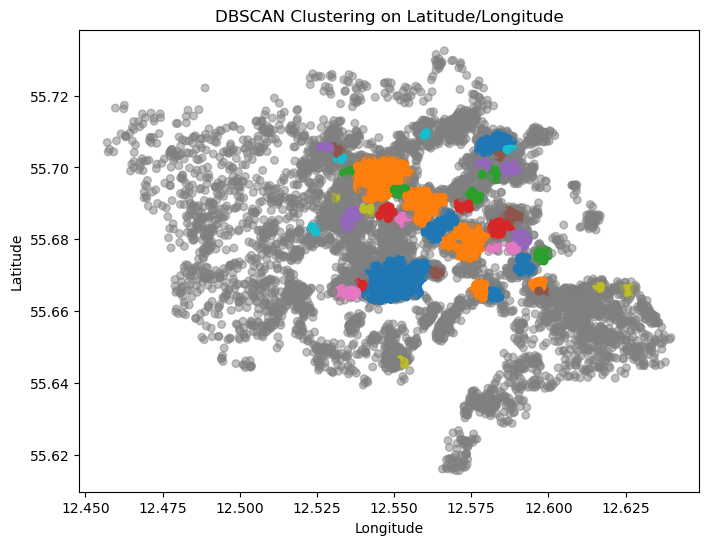

In [8]:
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# --- Assume df is already loaded and contains 'longitude' and 'latitude' columns ---

# Step 1: Extract the features
X = df[['longitude', 'latitude']].values

# Step 2: Standardize the data (important for DBSCAN performance)
X_scaled = StandardScaler().fit_transform(X)

# Step 3: Run DBSCAN
# eps controls the neighborhood radius; min_samples controls cluster density requirement
db = DBSCAN(eps=0.045, min_samples=20).fit(X_scaled)

# Step 4: Add cluster labels back to the dataframe
df['db-cluster'] = db.labels_

# Step 5: Plot the results
palette = plt.cm.get_cmap('tab10', np.max(df['db-cluster']) + 2)
colors = [palette(x) if x != -1 else (0.5, 0.5, 0.5, 0.5) for x in df['db-cluster']]
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=colors, s=30)
plt.title('DBSCAN Clustering on Latitude/Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()


In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hdbscan

# --- Assume df is already loaded and contains 'latitude' and 'longitude' columns ---

# Step 1: Extract coordinates
coords = df[['latitude', 'longitude']].values

# Step 2: Convert degrees to radians (required for haversine distance)
coords_rad = np.radians(coords)

# Step 3: Run HDBSCAN with Haversine metric
# min_cluster_size = minimum number of points per cluster
clusterer = hdbscan.HDBSCAN(min_cluster_size=12, metric='haversine')
cluster_labels = clusterer.fit_predict(coords_rad)

# Step 4: Add cluster labels to DataFrame
df['hdb-cluster'] = cluster_labels

# Step 5: Plot results
palette = plt.cm.get_cmap('tab10', np.max(df['hdb-cluster']) + 2)
colors = [palette(x) if x != -1 else (0.5, 0.5, 0.5, 0.5) for x in df['hdb-cluster']]
plt.figure(figsize=(8, 6))
plt.scatter(df['longitude'], df['latitude'], c=colors, s=30)
plt.title('HDBSCAN Clustering (Haversine Distance) with Noise Points')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

# Step 6: Print summary
num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
num_noise = list(cluster_labels).count(-1)
print(f"Clusters found: {num_clusters}")
print(f"Noise points: {num_noise}")


ModuleNotFoundError: No module named 'hdbscan'

In [ ]:
import folium
import matplotlib.pyplot as plt
import numpy as np

# --- Assume df already contains: latitude, longitude, cluster ---

# Step 1: Create a base map centered around the data
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Step 2: Define color palette
# Get unique cluster labels
clusters = sorted(df['hdb-cluster'].unique())

# Create a colormap using matplotlib (tab10 or any other)
cmap = plt.cm.get_cmap('tab10', len(clusters))
colors = {cluster: f'rgba({int(r*255)}, {int(g*255)}, {int(b*255)}, 0.8)'
          for cluster, (r, g, b, _) in zip(clusters, cmap(range(len(clusters))))}

# Step 3: Assign a neutral grey color to noise points (-1)
colors[-1] = 'rgba(150,150,150,0.5)'  # semi-transparent grey

# Step 4: Plot each point as a colored CircleMarker
for _, row in df.iterrows():
    cluster = row['hdb-cluster']
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color=colors[cluster],
        fill=True,
        fill_color=colors[cluster],
        fill_opacity=0.3,
        opacity=0.5,
        popup=f'Cluster: {cluster}'
    ).add_to(m)

# Step 5: Display the map
m


/var/folders/g9/wl8_th957sb253jg5r8b8t5w0000gn/T/ipykernel_16105/707500893.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', len(clusters))


In [ ]:
# Convert price column to float
df['price'] = (
    df['price']
    .astype(str)
    .str.replace('[^\d.]', '', regex=True)  # fjerner alt der ikke er tal eller punktum
    .astype(float)
)

In [ ]:
# Statistics on the clusters
cluster_means = df.groupby('k-cluster')['price'].mean().round(1)
print(cluster_means)

k-cluster
0     1106.7
1     1254.2
2     1587.7
3     2096.2
4     1101.1
5     1128.8
6     1420.3
7     1419.1
8     1411.4
9     1305.4
10    1004.8
11    1597.7
Name: price, dtype: float64


In [ ]:
# Sentiment analysis of comments
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk
nltk.download('vader_lexicon')

sia = SentimentIntensityAnalyzer()

df['sentiment'] = df['comments'].astype(str).apply(lambda x: sia.polarity_scores(x)['compound'])

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/fridafrandsen/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


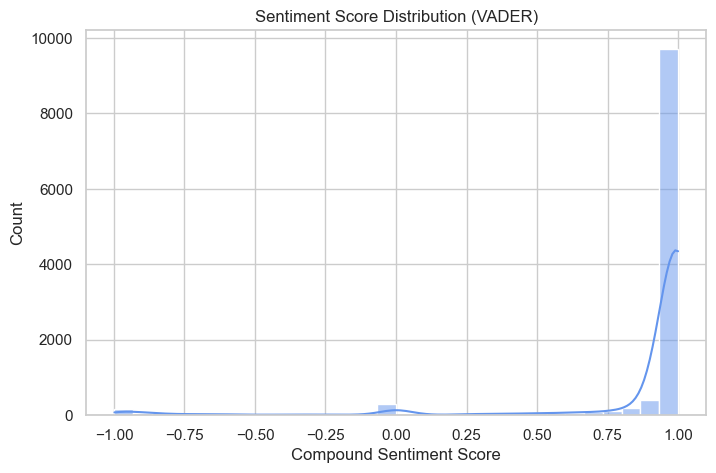

In [ ]:
# Distribution of sentiments (1 is very positive, -1 very negative)
sns.set(style="whitegrid")
plt.figure(figsize=(8,5))
sns.histplot(df['sentiment'], bins=30, kde=True, color='cornflowerblue')
plt.title('Sentiment Score Distribution (VADER)')
plt.xlabel('Compound Sentiment Score')
plt.ylabel('Count')
plt.show()

In [ ]:
cluster_summary = df.groupby('k-cluster').agg({
    'price': 'mean',
    'sentiment': 'mean',
    'review_scores_rating': 'mean', # Ved ikke hvilken review kolonne det skal være
    'id': 'count'
}).round(2)

print(cluster_summary)

             price  sentiment  review_scores_rating    id
k-cluster                                                
0          1106.74       0.84                  4.84  1104
1          1254.20       0.86                  4.83   987
2          1587.75       0.89                  4.84   930
3          2096.16       0.95                  4.78  1151
4          1101.09       0.82                  4.81   571
5          1128.83       0.87                  4.84  1498
6          1420.32       0.87                  4.85  1151
7          1419.11       0.81                  4.86   455
8          1411.36       0.89                  4.86  1892
9          1305.35       0.88                  4.82   311
10         1004.76       0.76                  4.79   432
11         1597.68       0.92                  4.84  1099


In [ ]:
# Map of clusters

# Step 1: Create a base map centered around the data
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Step 2: Define color palette
# Get unique cluster labels
clusters = sorted(df['k-cluster'].unique())

# Create a colormap using matplotlib (tab10 or any other)
cmap = plt.cm.get_cmap('tab10', len(clusters))
colors = {cluster: f'rgba({int(r*255)}, {int(g*255)}, {int(b*255)}, 0.8)'
          for cluster, (r, g, b, _) in zip(clusters, cmap(range(len(clusters))))}

# Step 3: Assign a neutral grey color to noise points (-1)
colors[-1] = 'rgba(150,150,150,0.5)'  # semi-transparent grey

# Step 4: Plot each point as a colored CircleMarker
for _, row in df.iterrows():
    cluster = row['k-cluster']
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color=colors[cluster],
        fill=True,
        fill_color=colors[cluster],
        fill_opacity=0.3,
        opacity=0.5,
        popup=f'Cluster: {cluster}'
    ).add_to(m)

for cl, row in cluster_summary.iterrows():
    subset = df[df['k-cluster'] == cl]
    folium.Marker(
        location=[
            subset['latitude'].mean(),
            subset['longitude'].mean()
        ],
        popup=(
            f"Cluster {cl}<br>"
            f"Average price: {row['price']:.0f} DKK<br>"
            f"Average sentiment: {row['sentiment']:.2f}<br>"
            f"Average review rating: {row['review_scores_rating']:.2f}<br>"
            f"Listings: {int(row['id'])}"
        )
    ).add_to(m)

# Step 5: Display the map
m

/var/folders/g9/wl8_th957sb253jg5r8b8t5w0000gn/T/ipykernel_16105/896897816.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab10', len(clusters))


Correlation between distance and price: -0.257 (negative means closer = higher price)


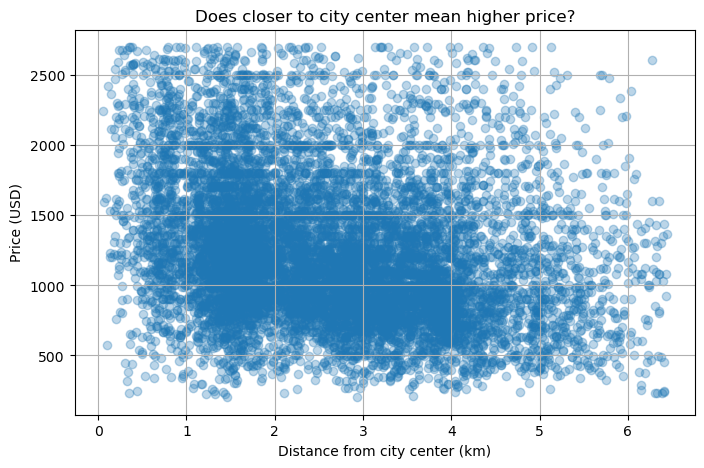

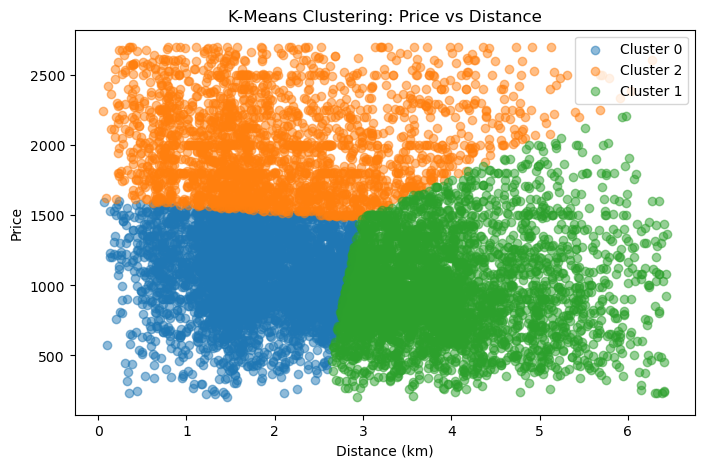

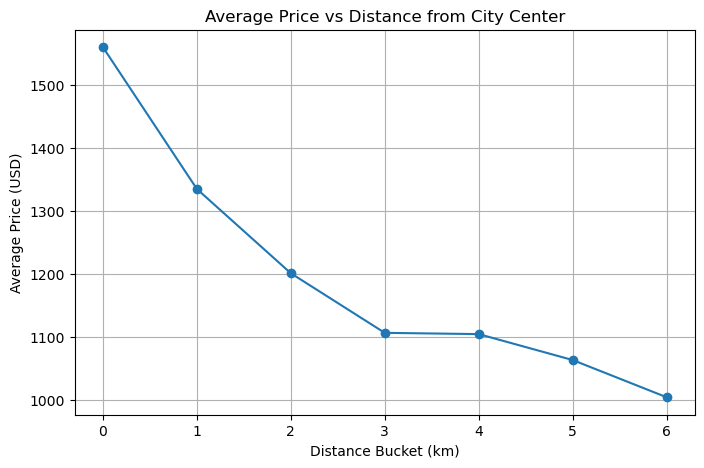

Average price by distance bucket (MapReduce style):
   distance_bucket    avg_price
0                0  1559.413517
1                1  1334.788965
2                2  1201.313928
3                3  1106.905590
4                4  1104.914207
5                5  1063.837900
6                6  1004.917808


In [13]:
# --- Airbnb Price vs City Center Analysis ---
# Question: Does closer to the city center equal a higher price?

import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from math import radians, sin, cos, sqrt, atan2

def remove_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

# Remove outliers from both price and distance
before = len(df)
df = remove_outliers(df, "price")
df = remove_outliers(df, "distance_km")



# --- 1. Clean and prepare numeric columns ---
# Extract numeric price
df["price"] = (
    df["price"]
    .astype(str)
    .replace('[\$,]', '', regex=True)
    .astype(float)
)

# Drop rows with missing coordinates
df = df.dropna(subset=["latitude", "longitude", "price"])

# --- 2. Compute distance from city center ---
# Define city center (e.g., Copenhagen)
city_center_lat, city_center_lon = 55.6761, 12.5683

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # Earth radius in km
    dlat, dlon = radians(lat2 - lat1), radians(lon2 - lon1)
    a = sin(dlat / 2)**2 + cos(radians(lat1)) * cos(radians(lat2)) * sin(dlon / 2)**2
    return 2 * R * atan2(sqrt(a), sqrt(1 - a))

df["distance_km"] = df.apply(
    lambda row: haversine(city_center_lat, city_center_lon, row["latitude"], row["longitude"]),
    axis=1
)

# --- 3. Correlation and scatter plot ---
corr = df["distance_km"].corr(df["price"])
print(f"Correlation between distance and price: {corr:.3f} (negative means closer = higher price)")

plt.figure(figsize=(8,5))
plt.scatter(df["distance_km"], df["price"], alpha=0.3)
plt.xlabel("Distance from city center (km)")
plt.ylabel("Price (USD)")
plt.title("Does closer to city center mean higher price?")
plt.grid(True)
plt.show()

# --- 4. Cluster listings by price and distance ---
scaler = StandardScaler()
X = scaler.fit_transform(df[["distance_km", "price"]])

kmeans = KMeans(n_clusters=3, random_state=42)
df["cluster"] = kmeans.fit_predict(X)

# Visualize clusters
plt.figure(figsize=(8,5))
for c in df["cluster"].unique():
    subset = df[df["cluster"] == c]
    plt.scatter(subset["distance_km"], subset["price"], label=f"Cluster {c}", alpha=0.5)
plt.xlabel("Distance (km)")
plt.ylabel("Price")
plt.title("K-Means Clustering: Price vs Distance")
plt.legend()
plt.show()

# --- 5. (Optional) MapReduce-style analysis ---
# Simulate Mapper: bucket by distance
df["distance_bucket"] = (df["distance_km"] // 1).astype(int)

# Simulate Reducer: compute average price per bucket
bucket_avg = (
    df.groupby("distance_bucket")["price"]
    .mean()
    .reset_index()
    .rename(columns={"price": "avg_price"})
)

plt.figure(figsize=(8,5))
plt.plot(bucket_avg["distance_bucket"], bucket_avg["avg_price"], marker="o")
plt.xlabel("Distance Bucket (km)")
plt.ylabel("Average Price (USD)")
plt.title("Average Price vs Distance from City Center")
plt.grid(True)
plt.show()

print("Average price by distance bucket (MapReduce style):")
print(bucket_avg.head(10))


Total hosts: 9866, total listings: 10805
The top 45.25% of hosts own 50% of all listings.
Gini coefficient of ownership = 0.086 (0=equal, 1=max inequality)


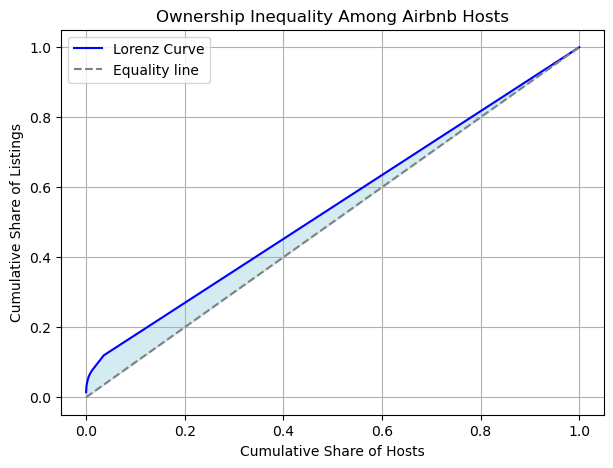


Distribution of ownership:


C:\Users\morte\AppData\Local\Temp\ipykernel_8388\2276119516.py:49: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bucket_summary = host_counts.groupby("bucket")["num_listings"].agg(["count", "sum"])


,count,sum,%_of_hosts,%_of_listings
bucket,,,,
1,9517,9517,96.462599,88.079593
2–5,299,663,3.030610,6.136048
6–10,37,235,0.375025,2.174919
11–20,7,93,0.070951,0.860713
21–50,5,141,0.050679,1.304951
51–100,0,0,0.000000,0.000000
100+,1,156,0.010136,1.443776


In [15]:
# --- 1. Count listings per host ---
host_counts = (
    df.groupby("host_id")
    .size()
    .reset_index(name="num_listings")
    .sort_values(by="num_listings", ascending=False)
)

total_hosts = len(host_counts)
total_listings = len(df)
print(f"Total hosts: {total_hosts}, total listings: {total_listings}")

# --- 2. Compute cumulative ownership ---
host_counts["cum_listings"] = host_counts["num_listings"].cumsum()
host_counts["cum_share"] = host_counts["cum_listings"] / total_listings
host_counts["host_share"] = np.arange(1, total_hosts + 1) / total_hosts

# --- 3. Find percentage of hosts that own 50% of all listings ---
half_point = host_counts[host_counts["cum_share"] >= 0.5].iloc[0]
top_fraction = half_point["host_share"]
print(f"The top {top_fraction*100:.2f}% of hosts own 50% of all listings.")

# --- 4. Gini coefficient (inequality measure) ---
def gini(array):
    array = np.sort(array)
    n = len(array)
    cumulative = np.cumsum(array)
    return (n + 1 - 2 * np.sum(cumulative) / cumulative[-1]) / n

gini_index = gini(host_counts["num_listings"].values)
print(f"Gini coefficient of ownership = {gini_index:.3f} (0=equal, 1=max inequality)")

# --- 5. Plot Lorenz curve ---
plt.figure(figsize=(7,5))
plt.plot(host_counts["host_share"], host_counts["cum_share"], label="Lorenz Curve", color="blue")
plt.plot([0,1], [0,1], "--", color="gray", label="Equality line")
plt.fill_between(host_counts["host_share"], host_counts["cum_share"], host_counts["host_share"], color="lightblue", alpha=0.5)
plt.title("Ownership Inequality Among Airbnb Hosts")
plt.xlabel("Cumulative Share of Hosts")
plt.ylabel("Cumulative Share of Listings")
plt.legend()
plt.grid(True)
plt.show()

# --- 6. Optional: Bucket summary ---
bins = [1, 2, 5, 10, 20, 50, 100, np.inf]
labels = ["1", "2–5", "6–10", "11–20", "21–50", "51–100", "100+"]
host_counts["bucket"] = pd.cut(host_counts["num_listings"], bins=bins, labels=labels, right=False)
bucket_summary = host_counts.groupby("bucket")["num_listings"].agg(["count", "sum"])
bucket_summary["%_of_hosts"] = bucket_summary["count"] / total_hosts * 100
bucket_summary["%_of_listings"] = bucket_summary["sum"] / total_listings * 100
print("\nDistribution of ownership:")
display(bucket_summary)

In [17]:
df["rented_days"]

0        347
1        361
2        255
3        357
4        139
        ... 
11576    359
11577     22
11578    199
11579      7
11580      3
Name: rented_days, Length: 10805, dtype: int64

9,405 listings are rented out more than 70 days per year.
That’s 87.04% of all listings.


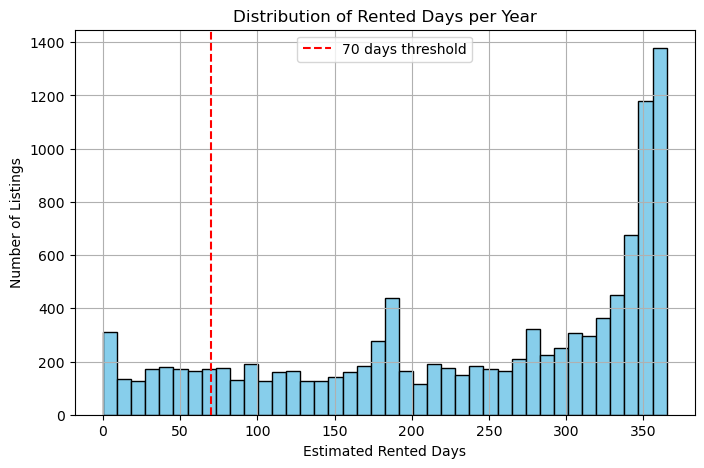


Percentage of listings by rented-day bucket:
rented_bucket
0–30        5.32%
31–70       7.14%
71–150     12.18%
151–250     20.3%
251–365    55.05%
Name: proportion, dtype: object


In [19]:
df["rented_days"] = 365 - df["availability_365"]

# --- 2. Calculate percentage of listings rented > 70 days ---
rented_over_70 = (df["rented_days"] > 70).sum()
total = len(df)
percentage = rented_over_70 / total * 100

print(f"{rented_over_70:,} listings are rented out more than 70 days per year.")
print(f"That’s {percentage:.2f}% of all listings.")

# --- 3. Optional: visualize distribution of rented days ---
import matplotlib.pyplot as plt

plt.figure(figsize=(8,5))
plt.hist(df["rented_days"], bins=40, color="skyblue", edgecolor="black")
plt.axvline(70, color="red", linestyle="--", label="70 days threshold")
plt.title("Distribution of Rented Days per Year")
plt.xlabel("Estimated Rented Days")
plt.ylabel("Number of Listings")
plt.legend()
plt.grid(True)
plt.show()

# --- 4. Optional summary table ---
bins = [0, 30, 70, 150, 250, 365]
labels = ["0–30", "31–70", "71–150", "151–250", "251–365"]
df["rented_bucket"] = pd.cut(df["rented_days"], bins=bins, labels=labels, right=True)
summary = df["rented_bucket"].value_counts(normalize=True).sort_index() * 100
print("\nPercentage of listings by rented-day bucket:")
print(summary.round(2).astype(str) + "%")

# Nedenstående er et estimat, man kan åbenbart ikke finde antallet af nætter lejet 

Max value in estimated_occupancy_l365d: 255
77 apartments are estimated to be rented more than 70 nights per year.
That’s 74.04% of all apartments with occupancy data.


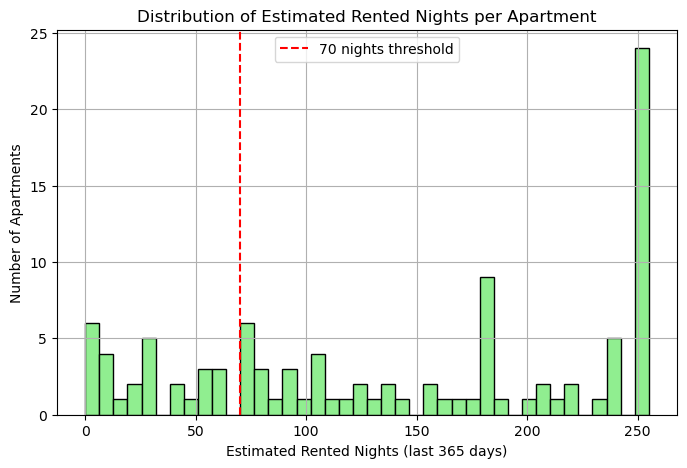


Percentage of apartments by rented-night bucket:
rented_bucket
0–30       14.0%
31–70       9.0%
71–150     26.0%
151–250    27.0%
251–365    24.0%
Name: proportion, dtype: object


C:\Users\morte\AppData\Local\Temp\ipykernel_8388\2202790260.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_apartments["rented_bucket"] = pd.cut(df_apartments["rented_nights"], bins=bins, labels=labels, right=True)


In [22]:
df = df.dropna(subset=["estimated_occupancy_l365d"])

# Check scale of occupancy
max_val = df["estimated_occupancy_l365d"].max()
print(f"Max value in estimated_occupancy_l365d: {max_val}")

# --- 2. Determine correct scale ---
if max_val <= 1.5:
    # Values are in 0–1 range (fraction of year)
    df["rented_nights"] = df["estimated_occupancy_l365d"] * 365
else:
    # Values are already in days (0–365)
    df["rented_nights"] = df["estimated_occupancy_l365d"]

# --- 3. Filter apartments only ---
df_apartments = df[df["property_type"].str.contains("Apartment", case=False, na=False)]

# --- 4. Calculate how many are rented > 70 nights ---
rented_over_70 = (df_apartments["rented_nights"] > 70).sum()
total_apartments = len(df_apartments)
pct = rented_over_70 / total_apartments * 100

print(f"{rented_over_70:,} apartments are estimated to be rented more than 70 nights per year.")
print(f"That’s {pct:.2f}% of all apartments with occupancy data.")

# --- 5. Visualize distribution ---
plt.figure(figsize=(8,5))
plt.hist(df_apartments["rented_nights"], bins=40, color="lightgreen", edgecolor="black")
plt.axvline(70, color="red", linestyle="--", label="70 nights threshold")
plt.title("Distribution of Estimated Rented Nights per Apartment")
plt.xlabel("Estimated Rented Nights (last 365 days)")
plt.ylabel("Number of Apartments")
plt.legend()
plt.grid(True)
plt.show()

# --- 6. Optional summary buckets ---
bins = [0, 30, 70, 150, 250, 365]
labels = ["0–30", "31–70", "71–150", "151–250", "251–365"]
df_apartments["rented_bucket"] = pd.cut(df_apartments["rented_nights"], bins=bins, labels=labels, right=True)

summary = df_apartments["rented_bucket"].value_counts(normalize=True).sort_index() * 100
print("\nPercentage of apartments by rented-night bucket:")
print(summary.round(2).astype(str) + "%")

# I københavns kommune må man kan leje ud 70 dage om året